In [29]:
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import torchvision.utils as vutils

In [30]:
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
device = torch.device(device)

In [31]:
img_dim = 28
cats = np.load('data/quickdraw/full_numpy_bitmap_cat.npy').reshape(-1, 1, img_dim, img_dim) / 255
dogs = np.load('data/quickdraw/full_numpy_bitmap_dog.npy').reshape(-1, 1, img_dim, img_dim) / 255

n_cats = cats.shape[0]
# n_dogs = dogs.shape[0]

x = cats  # np.concatenate((cats, dogs))
y = np.ones(n_cats)  # np.concatenate((np.zeros(n_cats), np.ones(n_dogs)))

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=.1, shuffle=True, random_state=69)

train_data = TensorDataset(torch.tensor(x_train).float(), torch.tensor(y_train).float())
test_data  = TensorDataset(torch.tensor(x_test).float(),  torch.tensor(y_test).float())

trainloader = DataLoader(train_data, batch_size=64, shuffle=True)
testloader = DataLoader(test_data, batch_size=64, shuffle=True)


In [32]:
class Generator(nn.Module):
    def __init__(self,
                 latent_dim: int = 100):
        super().__init__()
        
        self.latent_dim = latent_dim
        
        self.sequence = nn.Sequential(
            # Linear
            nn.Linear(latent_dim, 128),
            nn.ReLU(True),
            nn.Linear(128, 3 * 3 * 32),
            nn.ReLU(True),
            # Reshape
            nn.Unflatten(1, (32, 3, 3)),
            # Convolve
            nn.ConvTranspose2d(32, 16, 3, stride=2, output_padding=0),
            nn.BatchNorm2d(16),
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 1, 3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.sequence(x)
    
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.sequence = nn.Sequential(
            nn.Flatten(),
            nn.Linear(28*28, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.sequence(x)

In [33]:
latent_dim = 100

fixed_noise = torch.randn(64, latent_dim, device=device)

real_label = 1.
fake_label = 0.

generator = Generator(latent_dim=latent_dim).to(device)
discriminator = Discriminator().to(device)

loss_fn = nn.BCELoss()

lr = 1e-3
g_optim = torch.optim.Adam(generator.parameters(), lr=lr)
d_optim = torch.optim.Adam(discriminator.parameters(), lr=lr)

n_epochs = 100

img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(1, n_epochs + 1):
    for i, (real, _) in enumerate(trainloader):
        ## train the discriminator on real data
        # make the discriminator predict on the real data
        real = real.to(device)
        b_size = real.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = discriminator(real).view(-1)
        
        # calculate the loss
        d_loss_real = loss_fn(output, label)
        
        ## train the discriminator on fake data
        # generate fake data
        noise = torch.randn(b_size, latent_dim, device=device)
        fake = generator(noise)
        label = label.clone().fill_(fake_label)
        
        # make the discriminator predict on the fake data
        output = discriminator(fake.detach()).view(-1)
        
        # calculate the loss
        d_loss_fake = loss_fn(output, label)

        # compute full loss and backpropagate       
        d_loss = d_loss_real + d_loss_fake
        d_optim.zero_grad()
        d_loss.backward()
        d_optim.step()
        
        
        ## train the generator
        label.fill_(real_label)
        
        # make the discriminator predict on the fake data
        output = discriminator(fake).view(-1)
        
        # calculate the loss for the generator
        g_loss = loss_fn(output, label)
        
        # backpropagate
        g_optim.zero_grad()
        g_loss.backward()
        g_optim.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f'
                % (epoch, n_epochs, i, len(trainloader),
                    d_loss.item(), g_loss.item()))

        # Save Losses for plotting later
        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == n_epochs-1) and (i == len(trainloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1


[1/100][0/1733]	Loss_D: 1.3958	Loss_G: 1.0018
[1/100][50/1733]	Loss_D: 0.0046	Loss_G: 9.3355
[1/100][100/1733]	Loss_D: 0.0081	Loss_G: 8.2763
[1/100][150/1733]	Loss_D: 0.0563	Loss_G: 9.0642
[1/100][200/1733]	Loss_D: 0.1658	Loss_G: 4.1653
[1/100][250/1733]	Loss_D: 0.0221	Loss_G: 6.0818
[1/100][300/1733]	Loss_D: 0.0395	Loss_G: 4.9233
[1/100][350/1733]	Loss_D: 0.0309	Loss_G: 4.6635
[1/100][400/1733]	Loss_D: 0.0500	Loss_G: 6.2521
[1/100][450/1733]	Loss_D: 0.0524	Loss_G: 4.7006
[1/100][500/1733]	Loss_D: 0.0150	Loss_G: 5.6340
[1/100][550/1733]	Loss_D: 0.0141	Loss_G: 5.9120
[1/100][600/1733]	Loss_D: 0.0043	Loss_G: 5.7315
[1/100][650/1733]	Loss_D: 0.0189	Loss_G: 4.4628
[1/100][700/1733]	Loss_D: 0.0307	Loss_G: 4.0154
[1/100][750/1733]	Loss_D: 0.0174	Loss_G: 4.1393
[1/100][800/1733]	Loss_D: 0.0194	Loss_G: 4.0244
[1/100][850/1733]	Loss_D: 0.0155	Loss_G: 4.2391
[1/100][900/1733]	Loss_D: 0.0124	Loss_G: 4.4490
[1/100][950/1733]	Loss_D: 0.0075	Loss_G: 4.9482
[1/100][1000/1733]	Loss_D: 0.0018	Loss_G: 6

KeyboardInterrupt: 

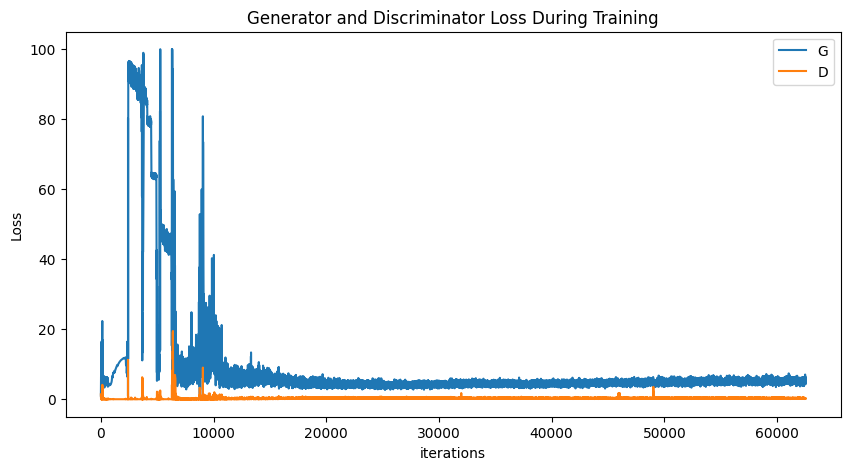

In [34]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

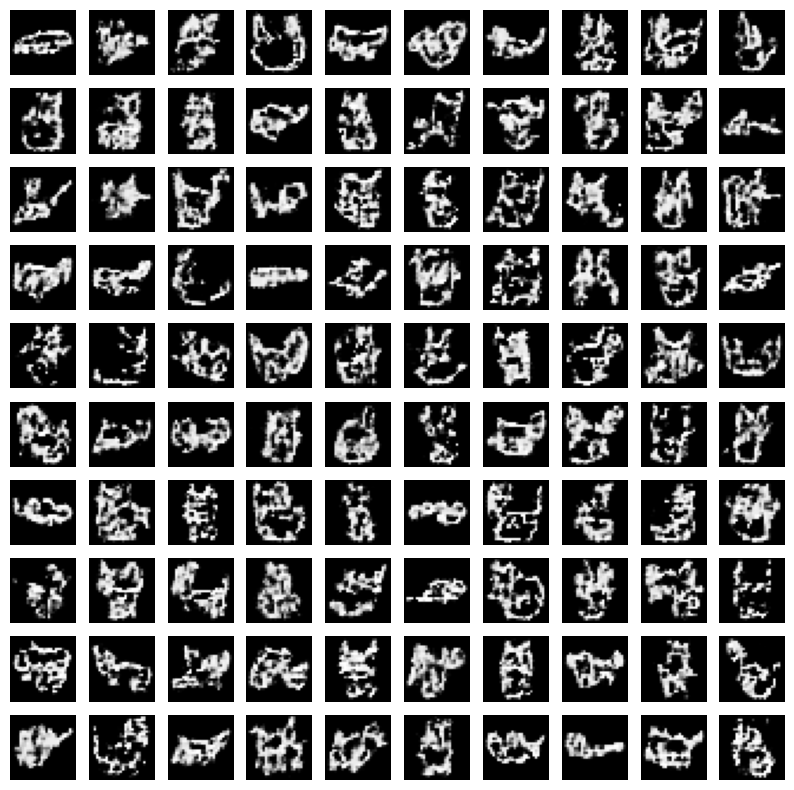

In [35]:

# write a function to generate a grid of images
def generate_grid(generator, latent_dim=100, n=10):
    noise = torch.randn(n*n, latent_dim).to(device)
    x_hat = generator(noise)
    x_hat = x_hat.view(-1, 28, 28)
    x_hat = x_hat.detach().cpu().numpy()
    x_hat = np.transpose(x_hat, (1, 2, 0))
    fig, ax = plt.subplots(n, n, figsize=(n, n))
    for i in range(n):
        for j in range(n):
            ax[i, j].imshow(x_hat[:, :, i*n + j], cmap='gray')
            ax[i, j].axis('off')
    plt.show()

generate_grid(generator)

Animation size has reached 20996321 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


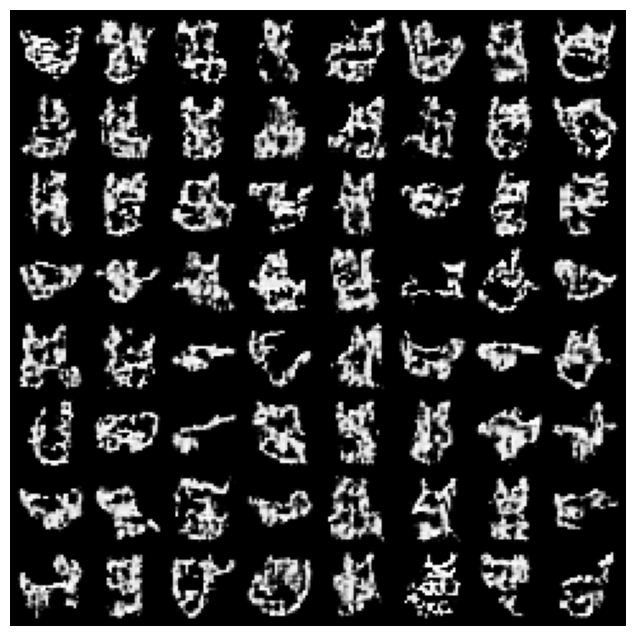

In [36]:
from IPython.display import HTML
import matplotlib.animation as animation

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())